In [21]:
from PIL import Image
import json
import os
import itertools
from matplotlib import pyplot

In [8]:
root_dir = '/home/dominik/Development/clevr-images-unambigous-colour/'
image_dir = os.path.join(root_dir, 'images')
scenes_dir = os.path.join(root_dir, 'scenes')
image_name = 'CLEVR_UNAMBIGOUS-COLOR_007887'

In [9]:
with open(os.path.join(scenes_dir, image_name + '.json'), encoding='utf-8') as f:
    scene = json.load(f)

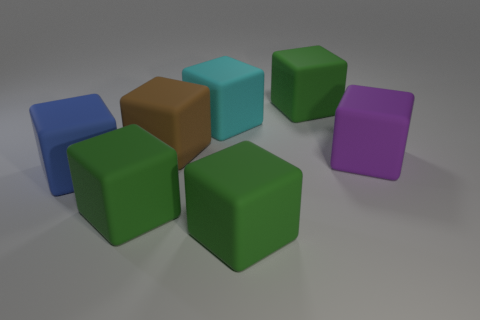

In [24]:

image = Image.open(os.path.join(image_dir, image_name + '.png')).convert('RGB')
image

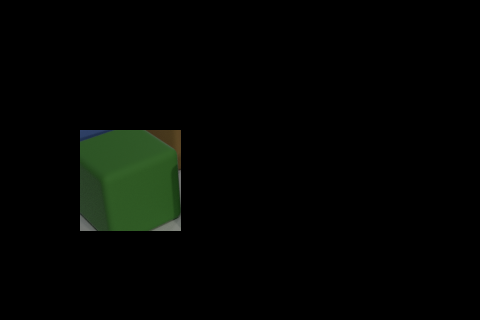

In [28]:
masked_image = image.copy()
pixels = masked_image.load()
x = 130
y = 180

mask_size = 50
for i, j in itertools.product(range(image.size[0]), range(image.size[1])): # for every pixel:
    if i < x-mask_size or i> x+mask_size or j < y-mask_size or j> y+mask_size:
        pixels[i, j] = (0,0,0)
masked_image


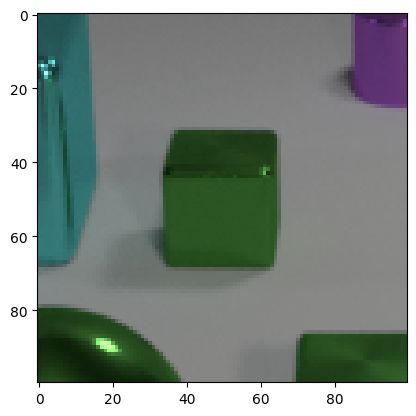

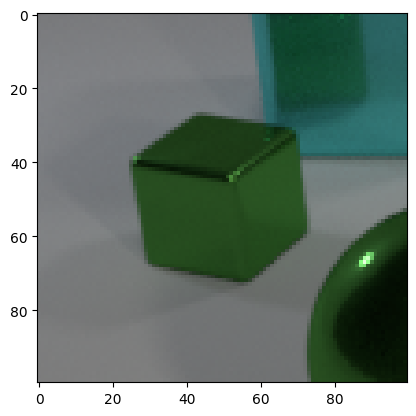

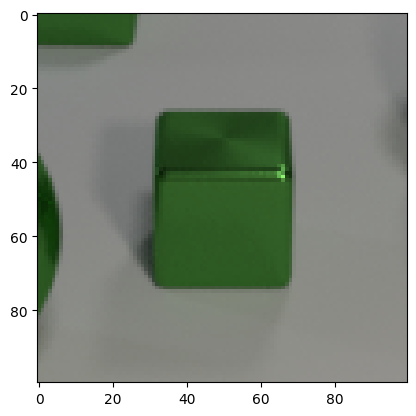

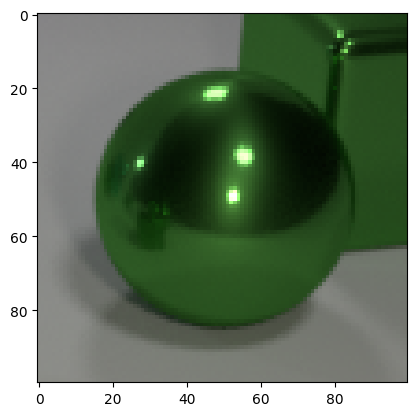

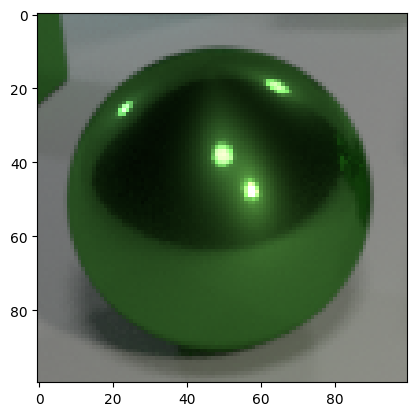

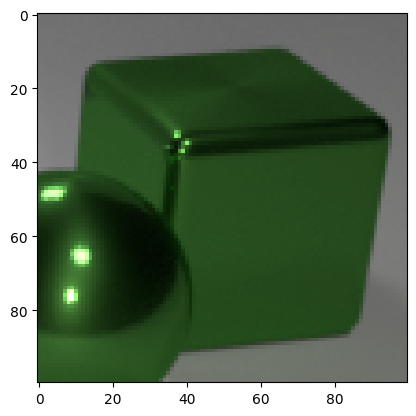

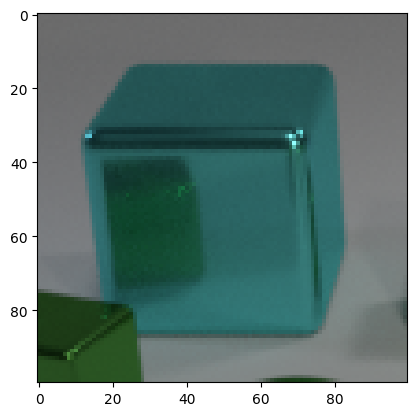

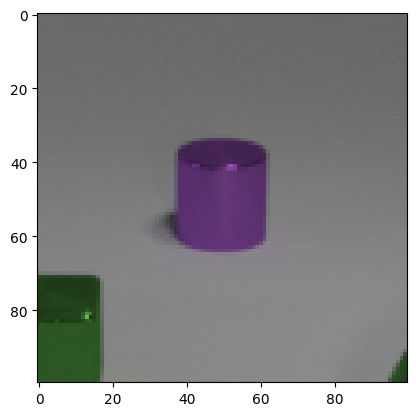

In [5]:
BOUNDING_BOX_SIZE = 100

object_bounding_boxes = []
for object in scene['objects']:
    x_center, y_center, depth = object['pixel_coords']
    object_bounding_boxes.append(image.crop(
        (x_center - BOUNDING_BOX_SIZE/2,
         y_center - BOUNDING_BOX_SIZE/2,
         x_center + BOUNDING_BOX_SIZE/2,
         y_center + BOUNDING_BOX_SIZE/2)
         ))

for image in object_bounding_boxes:
    pyplot.imshow(image)
    pyplot.show()

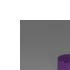

In [6]:
new = image.crop((-20,-20, 50,50))
new.size
new

In [2]:
from torchvision.models.resnet import resnet101, ResNet101_Weights
from torch import nn

resnet = resnet101(weights=ResNet101_Weights.IMAGENET1K_V2)

for param in resnet.parameters():
    param.requires_grad = False
resnet.eval()

# self.resnet = nn.Sequential(*list(resnet.children())[:-2])
resnet.avgpool = nn.AdaptiveAvgPool2d((7, 7))
resnet.fc = nn.Identity()

resnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [3]:
from torchvision.models import vgg19, VGG19_Weights
from torch import nn

vgg = vgg19(weights=VGG19_Weights.IMAGENET1K_V1)
vgg

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /home/dominik/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:21<00:00, 26.8MB/s] 


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [11]:

classifier = nn.Sequential(list(vgg.children())[-1][:-3])
adapted = vgg
adapted.classifier = classifier
adapted

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [6]:
import math


class Test():
    def __init__(self) -> None:
        self._f = (7,7,2048)
    
    @property
    def f(self):
        return self._f
    
test = Test()
math.prod(test.f)

100352

In [10]:
import os
from mlt.preexperiments.data_readers import ReferentialGameDataset
from PIL import Image
from matplotlib import pyplot

data_root = '/scratch/guskunkdo/clevr-images-unambigous-colour/'
image_path = os.path.join(data_root, 'images/') 
scenes_path = os.path.join(data_root, 'scenes/') 

In [11]:
dataset = ReferentialGameDataset(
        scenes_json_dir=scenes_path,
        image_path=image_path,
        max_number_samples=100,
    )

loading scenes...
creating combinations...
shuffling...
looping...


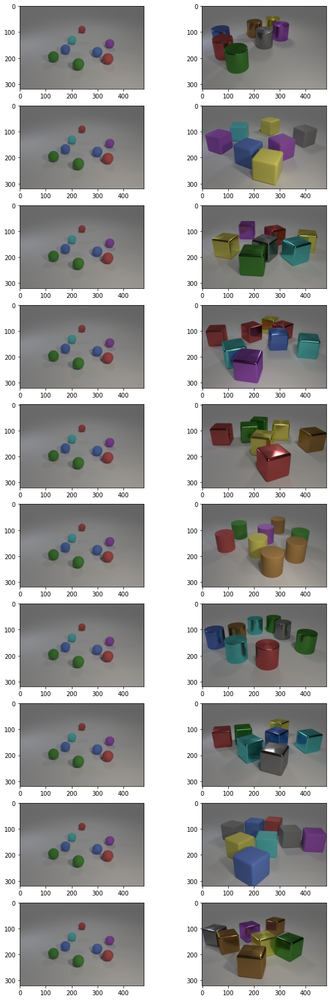

In [17]:
n_samples = 10
fig, ax = pyplot.subplots(nrows=n_samples, ncols=2)
fig.set_figwidth(10)
fig.set_figheight(3 * n_samples)
for index, sample in enumerate(dataset.samples[:n_samples]):
    image_1 = Image.open(image_path + sample.image_1_id)
    image_2 = Image.open(image_path + sample.image_2_id)
    ax[index, 0].imshow(image_1)
    ax[index, 1].imshow(image_2)
pyplot.show()

In [13]:
import torch
from matplotlib import pyplot
from imagenet_stubs.imagenet_2012_labels import label_to_name

In [2]:
interaction = torch.load('/home/dominik/Downloads/dessi_etal_data.interaction')
type(interaction)

egg.core.interaction.Interaction

In [3]:
print(len(interaction.sender_input))
print(type(interaction.sender_input[5]))

5000
<class 'torch.Tensor'>


hammerhead, hammerhead shark


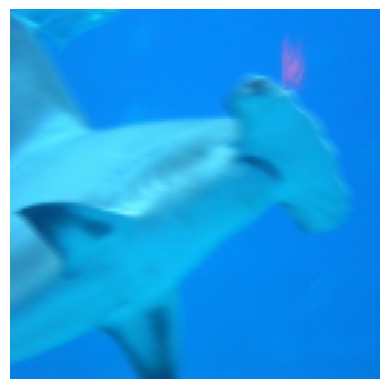

In [19]:
img_idx = 11 #@param {type:"integer"}

pyplot.axis('off')
sender_input = interaction.sender_input[img_idx]
sender_input -= sender_input.min()
sender_input /= sender_input.max()
print(label_to_name(interaction.labels[img_idx].item()))
pyplot.imshow(sender_input.permute(1, 2, 0))


In [2]:
import h5py
import os
import pickle

root_dir = '/home/dominik/Downloads/signaling_game_data/'


In [5]:
fc_file = os.path.join(root_dir, 'test', "ours_images_single_sm0.h5")
fc = h5py.File(fc_file, "r")
data = fc['dataset_1']
data[0].shape

(4096,)

In [22]:
objects_file = os.path.join(root_dir, 'test', "ours_images_single_sm1.objects")
with open(objects_file, "rb") as f:
    labels = pickle.load(f)

len(set(labels))

461

In [14]:
paths_file = os.path.join(root_dir, 'test', "ours_images_paths_sm0.objects")
with open(paths_file, "rb") as f:
    paths = pickle.load(f)

paths

array([['0', '/private/home/dianeb/OURDATA/Raw/test/accordion_101.jpg'],
       ['1', '/private/home/dianeb/OURDATA/Raw/test/accordion_102.jpg'],
       ['2', '/private/home/dianeb/OURDATA/Raw/test/accordion_103.jpg'],
       ...,
       ['135144', '/private/home/dianeb/OURDATA/Raw/test/zebra_398.jpg'],
       ['135145', '/private/home/dianeb/OURDATA/Raw/test/zebra_399.jpg'],
       ['135146', '/private/home/dianeb/OURDATA/Raw/test/zebra_400.jpg']],
      dtype='<U58')

In [23]:
list(zip(data, labels))

[(array([-2.44768953e+00, -4.56078815e+00, -4.29516506e+00, -6.21003485e+00,
         -5.19855213e+00, -1.41876435e+00, -4.61597538e+00,  1.34937954e+00,
          2.20616794e+00, -2.19861341e+00, -3.72111988e+00,  6.41028762e-01,
         -2.86723042e+00, -5.31970453e+00, -1.69967949e+00, -3.08044457e+00,
         -3.59688687e+00,  1.44989276e+00, -1.64307272e+00, -2.21068358e+00,
         -6.84164476e+00, -2.95149255e+00, -5.44205666e+00, -2.98617649e+00,
         -3.19157791e+00, -3.10046792e+00, -4.66920328e+00, -6.01747465e+00,
         -7.21414745e-01, -4.72329473e+00, -4.72467899e+00, -5.51769543e+00,
         -2.72663546e+00, -5.81974649e+00, -2.08505535e+00, -3.93523669e+00,
         -8.10606956e-01, -1.25134039e+00, -4.04828835e+00,  3.61503273e-01,
         -4.29929972e+00,  1.04149151e+00, -2.21429253e+00, -4.00165606e+00,
         -2.69325495e+00,  2.08862066e+00, -1.16655052e+00, -3.57884979e+00,
         -2.25446510e+00, -1.88837087e+00, -3.51523852e+00, -2.16211295e+00,

In [5]:
import h5py
with h5py.File('../../../features.h5', "r") as f:
    print(f['features'][0])

[[-0.47433835  0.08645391  0.07585302 ...  0.12520969 -0.7169055
   2.8541768 ]
 [-0.13836488  0.03579129  0.14275749 ...  0.24228883 -0.27250668
   1.964011  ]]


In [1]:
import random
l = [1,2,3,4,5,6,7,8]
r = random.sample(l, 5)
l


TypeError: Random.choice() takes 2 positional arguments but 3 were given

In [5]:
import torch

l = [True, False, True]
t = torch.tensor(l)

if t[1]:
    print('true')

t

tensor([ True, False,  True])

In [7]:
import torch

t = torch.rand((2,15,3))
print(t)
m = t.max(dim=1)
print(m.values.shape)

tensor([[[0.0870, 0.8082, 0.8644],
         [0.8405, 0.4000, 0.2476],
         [0.4032, 0.9535, 0.4107],
         [0.0377, 0.0621, 0.1225],
         [0.6126, 0.0080, 0.2400],
         [0.3077, 0.2100, 0.0097],
         [0.9185, 0.0890, 0.0632],
         [0.2665, 0.7106, 0.3684],
         [0.6391, 0.9789, 0.7290],
         [0.4961, 0.1816, 0.6276],
         [0.2263, 0.2447, 0.9879],
         [0.9291, 0.6664, 0.5159],
         [0.6509, 0.2551, 0.0775],
         [0.7753, 0.1473, 0.6326],
         [0.8324, 0.1459, 0.4183]],

        [[0.1382, 0.2618, 0.6276],
         [0.5710, 0.0550, 0.2482],
         [0.2551, 0.6794, 0.0404],
         [0.1734, 0.9888, 0.0878],
         [0.0977, 0.1133, 0.3297],
         [0.8776, 0.9305, 0.1647],
         [0.2090, 0.5939, 0.8122],
         [0.3496, 0.3315, 0.4438],
         [0.7282, 0.0450, 0.7309],
         [0.1609, 0.9370, 0.0857],
         [0.6097, 0.5670, 0.4950],
         [0.2895, 0.5764, 0.6603],
         [0.2825, 0.6129, 0.4427],
         [0.8420, 

In [8]:
import torch

torch.load('/home/dominik/Nextcloud/020_Masterstudium/Language Technology/LT2402_Master Thesis/experiments/runs/2023-07-25_14-49-47_dale_attribute_coordinate_predictor/interactions/train/epoch_5/interaction_gpu0')

Interaction(sender_input=tensor(0), receiver_input=tensor(0), labels=tensor([[ 39,  91],
        [115, 170],
        [ 24,  86],
        ...,
        [125, 102],
        [165, 105],
        [ 89, 178]]), aux_input={'masked_image': tensor(0), 'attribute_tensor': tensor(0), 'image_id': tensor([9451, 5678, 3764,  ...,  336, 4942, 1159])}, message=tensor([[[5.9078e-01, 2.0590e-05, 1.2898e-01,  ..., 9.3748e-04,
          5.1220e-07, 2.4879e-01],
         [1.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00]],

        [[3.6556e-01, 2.0068e-06, 1.4462e-02,  ..., 2.4750e-04,
          6.9928e-08, 6.1593e-01],
         [1.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00]],

        [[5.1002e-02, 9.3025e-08, 9.4764e-01,  ..., 4.1742e-05,
          1.5957e-07, 3.4216e-04],
         [1.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00]],

        ...,

        [[1.1942e-01, 1.8665e-04, 8.7358

In [1]:
from mlt.preexperiments.data_readers import SiftFeatureExtractor
from  PIL import Image
import cv2
import matplotlib.pyplot as plt


In [9]:
extractor = SiftFeatureExtractor()
image_path = "/home/dominik/Development/clevr-images-unambigous-colour/images/CLEVR_UNAMBIGOUS-COLOR_000000.png"
image = cv2.imread(image_path)
pil_image = Image.open(image_path)

In [10]:
keypoints, descriptors = extractor.get_features(pil_image)
print(keypoints[0].pt)
print(len(keypoints))

(60.83759307861328, 146.67250061035156)
26


In [11]:
image_with_keypoints = cv2.drawKeypoints(image, keypoints, None)

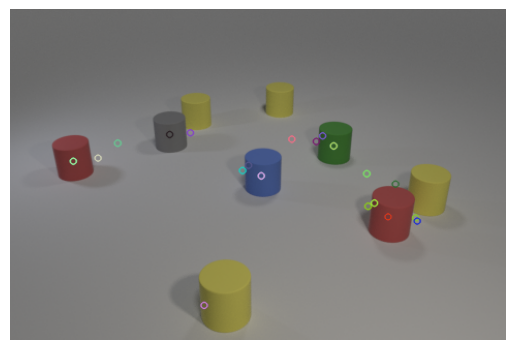

In [12]:
plt.imshow(cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.show()

In [1]:
from mlt.preexperiments.data_readers import AllObjectsImageMasker, SingleObjectImageMasker
import json
from PIL import Image
import os

root_path = "/home/dominik/Development/clevr-images-unambigous-colour/"
image_name = 'CLEVR_UNAMBIGOUS-COLOR_000000'

image = Image.open(os.path.join(root_path, 'images/', image_name + '.png'))

with open(os.path.join(root_path, 'scenes/', image_name + '.json'), 'r', encoding='utf-8') as f:
    scene = json.load(f)


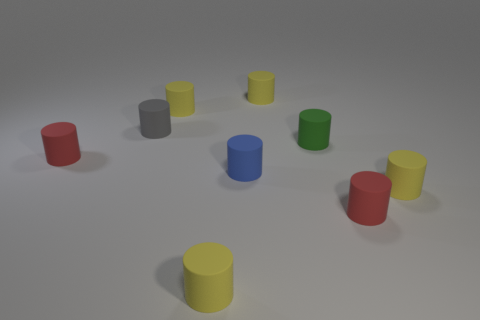

In [2]:
image

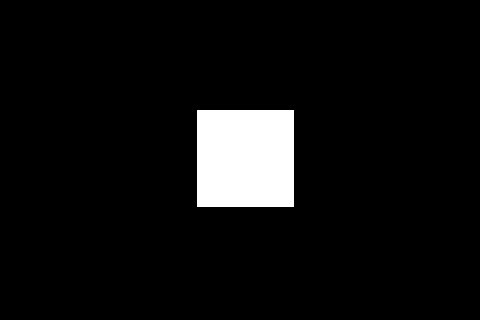

In [3]:
single_masker = SingleObjectImageMasker()
single_masked_image = single_masker.get_masked_image(image, scene, 0)
single_masked_image

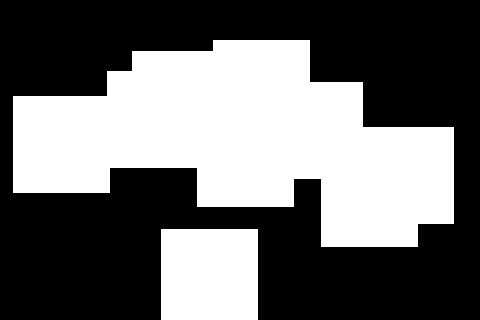

In [4]:
masker = AllObjectsImageMasker()
masked_image = masker.get_masked_image(image, scene, -1)
masked_image

In [4]:
class Test:
    pass

c = Test
print(c.__name__)

Test


In [5]:
import json
with open('/home/dominik/Development/MLT_Master-Thesis/out/2023-10-16_11-48-33_bounding_box_caption_generator_colour_100_30_500/log.txt', 'r', encoding='utf-8') as f:
    results = []
    for line in f:
        if line.startswith('{'):
            results.append(json.loads(line))
    print(results)

[{'accuracy': '0.12', 'word_by_word_accuracy': '0.71', 'accuracy_by_word': {'<pad>': 1.0, '<sos>': nan, 'small': nan, 'large': nan, 'gray': 0.0, 'red': 0.0, 'blue': 0.0, 'green': 0.0, 'brown': 0.0, 'purple': 0.33, 'cyan': 0.0, 'yellow': 0.69, 'cube': 1.0, 'sphere': 1.0, 'cylinder': 1.0}, 'word_by_word_precision': '0.30', 'precision_by_word': {'<pad>': 1.0, '<sos>': 0.0, 'small': 0.0, 'large': 0.0, 'gray': 0.0, 'red': 0.0, 'blue': 0.0, 'green': 0.0, 'brown': 0.0, 'purple': 0.13, 'cyan': 0.0, 'yellow': 0.12, 'cube': 1.0, 'sphere': 1.0, 'cylinder': 1.0}, 'word_by_word_recall': '0.36', 'recall_by_word': {'<pad>': 1.0, '<sos>': 0.0, 'small': 0.0, 'large': 0.0, 'gray': 0.0, 'red': 0.0, 'blue': 0.0, 'green': 0.0, 'brown': 0.0, 'purple': 0.33, 'cyan': 0.0, 'yellow': 0.69, 'cube': 1.0, 'sphere': 1.0, 'cylinder': 1.0}, 'non_target_accuracy': '0.34'}, {'accuracy': '0.25', 'word_by_word_accuracy': '0.75', 'accuracy_by_word': {'<pad>': 1.0, '<sos>': nan, 'small': nan, 'large': nan, 'gray': 0.4, 're

In [40]:
from dataclasses import dataclass
import h5py
import torch
from mlt.image_loader import FeatureImageLoader
from mlt.language_games.data_readers import DaleReferentialGameDataset

dataset = DaleReferentialGameDataset(
    scenes_json_dir='/home/dominik/Development/clevr-images-unambigous-dale/scenes/',
    image_loader=FeatureImageLoader(
            feature_file='/home/dominik/Development/clevr-images-unambigous-dale/features/bounding_box_resnet_4_avgpool_no-fc.h5',
            image_dir='/home/dominik/Development/clevr-images-unambigous-dale/images/'
        ),
    max_number_samples=100
)

# print([sample.bounding_boxes[0].shape for sample in dataset.samples])

with h5py.File('/home/dominik/Development/MLT_Master-Thesis/out/test.h5', "w") as f:
    f.create_dataset("bounding_boxes", data=torch.stack([torch.stack(sample.bounding_boxes) for sample in dataset.samples]))
    f.create_dataset("target_index", data=[sample.target_index for sample in dataset.samples])
    f.create_dataset("target_order", data=[sample.target_order for sample in dataset.samples])
    f.create_dataset("image_id", data=[sample.image_id for sample in dataset.samples])



sampling scenes...
processing scene 50...


In [56]:
from mlt.language_games.data_readers import DaleReferentialGameSample


with h5py.File('/home/dominik/Development/MLT_Master-Thesis/out/test.h5', "r") as f:
    print(f.keys())

    samples = [
                DaleReferentialGameSample(
                    **dict(
                        zip(
                            [
                                "bounding_boxes",
                                "image_id",
                                "target_index",
                                "target_order",
                            ],
                            sample,
                        )
                    )
                )
                for sample in zip(
                    [list(torch.from_numpy(s)) for s in f["bounding_boxes"]],
                    [str(i, "utf-8") for i in f["image_id"]],
                    f["target_index"],
                    [a.tolist() for a in f["target_order"]],
                )
            ]
    
    print(type(samples[0].target_order[0]))


<KeysViewHDF5 ['bounding_boxes', 'image_id', 'target_index', 'target_order']>
<class 'int'>


In [ ]:
import csv
import glob
from torcheval.metrics import (
    BinaryAccuracy,
    Mean,
    MulticlassAccuracy,
    MulticlassPrecision,
    MulticlassRecall,
)
import torch
import json
import os
import warnings


for folder in glob.glob('/home/dominik/Nextcloud/020_Masterstudium/Language Technology/LT2402_Master Thesis/experiments/pre-experiments/caption_generator/*caption*[0-9]*'):
    log_path = os.path.join(folder, 'log.txt')
    test_data_path = os.path.join(folder, 'test_outputs.csv')
    if not os.path.exists(log_path):
        continue
    
    vocab = set()
    target_list = []
    predicted_list = []
    with open(test_data_path, 'r', encoding='utf-8') as f:
        reader = csv.reader(f)
        next(reader)
        try:
            for image_id, predicted, target in reader:
                predicted = predicted.split(' ')
                target = target.split(' ')

                target_list.append(target)
                predicted_list.append(predicted)
                vocab.update(target, predicted)
        except:
            print(folder)

    vocab.update(['<sos>'])
    vocab = list(vocab)
    vocab_index = {word: index for index, word in enumerate(vocab)}

    target_tensor = torch.tensor([vocab_index[word] for re in target_list for word in re])
    predicted_tensor = torch.tensor([vocab_index[word] for re in predicted_list for word in re ])

    avg_accuracy = MulticlassAccuracy()
    accuracy = MulticlassAccuracy(average=None, num_classes=len(vocab))
    precision = MulticlassPrecision(average=None, num_classes=len(vocab))
    recall = MulticlassRecall(average=None, num_classes=len(vocab))

    warnings.filterwarnings("ignore")

    avg_accuracy.update(predicted_tensor, target_tensor)
    accuracy.update(predicted_tensor, target_tensor)
    precision.update(predicted_tensor, target_tensor)
    recall.update(predicted_tensor, target_tensor)
    acc = accuracy.compute()
    prec = precision.compute()
    rec = recall.compute()

    accuracy_by_word = {
        word: round(accuracy.item(), 4)
        for word, accuracy in zip(
            vocab, acc
        )
    }
    precision_by_word = {
        word: round(precision.item(), 4)
        for word, precision in zip(
            vocab, prec
        )
    }
    recall_by_word = {
        word: round(recall.item(), 4)
        for word, recall in zip(
            vocab, rec
        )
    }

    included_indices = [
        i
        for i, token in enumerate(vocab)
        if token != '<sos>'
    ]

    # print(torch.mean(acc[included_indices]), torch.mean(prec[included_indices]), torch.mean(rec[included_indices]))
    # print(accuracy_by_word)
    # print(precision_by_word)
    # print(recall_by_word)  

    with open(log_path, 'r+', encoding='utf-8') as f:
        lines = f.readlines()
        try:
            loaded_metrics = json.loads(lines[-1])
            loaded_metrics['word_by_word_accuracy'] = f'{avg_accuracy.compute():.4f}'
            loaded_metrics['word_by_word_precision'] = f'{torch.mean(prec[included_indices]).item():.4f}'
            loaded_metrics['word_by_word_recall'] = f'{torch.mean(rec[included_indices]).item():.4f}'

            for word in accuracy_by_word:
                loaded_metrics['accuracy_by_word'][word] = accuracy_by_word[word]
            for word in precision_by_word:
                loaded_metrics['precision_by_word'][word] = precision_by_word[word]
            for word in recall_by_word:
                loaded_metrics['recall_by_word'][word] = recall_by_word[word]

            lines[-1] = json.dumps(loaded_metrics) + os.linesep
            f.writelines(lines)

        except Exception as e:
            print(e)
            continue

In [2]:
import collections
import os
import json

def get_caption(o):
    target_shape = o["shape"]
    target_color = o["color"]
    target_size =  o["size"]

    caption = [target_shape]
    remaining_objects = [
        obj for obj in scene["objects"] if obj["shape"] == target_shape
    ]

    if len(remaining_objects) > 1:
        caption.insert(0, target_color)
        remaining_objects = [
            obj for obj in remaining_objects if obj["color"] == target_color
        ]

        if len(remaining_objects) > 1:
            caption.insert(0, target_size)
    
    return tuple(caption)

scenes_json_dir = '/home/dominik/Development/clevr-images-unambigous-colour/scenes/'

all_uniques = []
number_distractors = []
all_target_captions = set()
all_non_target_captions = set()
unique_non_target_captions = set()
differences = set()
scenes = os.listdir(scenes_json_dir)

for scene_file in scenes:
    with open(
        os.path.join(scenes_json_dir, scene_file), "r", encoding="utf-8"
    ) as f:
        scene = json.load(f)

    target_caption = get_caption(scene['objects'][0])
    non_target_captions = [get_caption(o) for o in scene['objects'][1:]]
    distractor_counter = collections.Counter(non_target_captions)
    uniques = [caption for caption, number in distractor_counter.items() if number == 1]
    all_uniques.append(len(uniques))
    number_distractors.append(len(scene['objects'][1:]))

    all_target_captions.add(target_caption)
    all_non_target_captions.update(non_target_captions)
    unique_non_target_captions.update(uniques)

    for unique in uniques:
        differences.update([u_word for u_word, t_word in zip(unique, target_caption) if u_word != t_word])
    

avg_uniqes = sum(all_uniques) / len(all_uniques)
print(sum(number_distractors) / len(number_distractors))
print(len(all_target_captions))
print(len(all_non_target_captions))
print(len(unique_non_target_captions))
print(len(differences))
print(avg_uniqes)
print(1/8 * avg_uniqes)





7.5056
24
72
24
8
2.715
0.339375


In [13]:
import collections
import json
import os
scenes_json_dir = '/home/dominik/Development/clevr-images-unambigous-colour/scenes/'
scenes = os.listdir(scenes_json_dir)

samples_with_one = collections.Counter()
samples_with_multiple = collections.Counter()
colors_sample_counter = collections.Counter()
for scene_index, scene_file in enumerate(scenes):
    with open(
        os.path.join(scenes_json_dir, scene_file), "r", encoding="utf-8"
    ) as f:
        scene = json.load(f)
    
    colors_sample_counter.update(set(object['color'] for object in scene['objects'][1:]))

    colors_counter = collections.Counter()
    colors_counter.update(o['color'] for o in scene['objects'][1:])
    samples_with_multiple.update({color: (1 if number > 1 else 0) for color, number in colors_counter.items()})
    samples_with_one.update({color: (1 if number == 1 else 0) for color, number in colors_counter.items()})

print(colors_sample_counter)
print(samples_with_one)
print(samples_with_multiple)
    

Counter({'red': 6011, 'blue': 5995, 'brown': 5969, 'green': 5968, 'purple': 5954, 'cyan': 5951, 'gray': 5926, 'yellow': 5904})
Counter({'brown': 3469, 'red': 3459, 'gray': 3407, 'cyan': 3404, 'yellow': 3399, 'blue': 3388, 'green': 3323, 'purple': 3301})
Counter({'purple': 2653, 'green': 2645, 'blue': 2607, 'red': 2552, 'cyan': 2547, 'gray': 2519, 'yellow': 2505, 'brown': 2500})


In [18]:
import h5py
from mlt.util import load_tensor

mask = '/home/dominik/Development/MLT_Master-Thesis/out/datasets/359d56a517b7e9c9249193f1c4d45558183cd30780b2a83e0e0e877b64a5d291.h5'
no_mask = '/home/dominik/Development/MLT_Master-Thesis/out/datasets/0ac7c9e6bb929dbf86a31cff97c5dbc78b69253ec7b05b69f9553140a699d398.h5'

with h5py.File(mask, "r") as f:
    print(f['masked_image'])
    print(type(f["masked_image"][0]))
    print(load_tensor(f["masked_image"][0]))


<HDF5 dataset "masked_image": shape (10000, 3, 224, 224), type "<f4">
<class 'numpy.ndarray'>
tensor([[[-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         ...,
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179]],

        [[-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         ...,
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357]],

        [[-1.8044, -1.

In [1]:
import h5py
import os

with h5py.File('t/test.h5', 'a') as f:
    dataset = f.create_dataset('test', (10,2,3))

    dataset[1] = (1,2)
    for sample in dataset:
        print(sample)

os.remove('test.h5')


FileNotFoundError: [Errno 2] Unable to create file (unable to open file: name = 't/test.h5', errno = 2, error message = 'No such file or directory', flags = 15, o_flags = c2)

In [8]:
from PIL import Image
from torchvision.models import ResNet101_Weights

preprocess = ResNet101_Weights.DEFAULT.transforms()

image = Image.open('/home/dominik/Development/clevr-images-unambigous-dale-two/images/CLEVR_UNAMBIGOUS-DALE-TWO_000000.png').convert(
                    "RGB"
                )
pre = preprocess(image)
pre[0,:].flatten().shape

torch.Size([50176])

In [58]:
from numpy import dtype
import torch
B = 2
C = 4
S = 3
P = 5

visual = torch.tensor([
    [[[1,2,3],[1,2,3],[1,2,3]],
     [[1,2,3],[1,2,3],[1,2,3]],
     [[1,2,3],[1,2,3],[1,2,3]],
     [[1,2,3],[1,2,3],[1,2,3]]],
    [[[1,2,3],[1,2,3],[1,2,3]],
     [[1,2,3],[1,2,3],[1,2,3]],
     [[1,2,3],[1,2,3],[1,2,3]],
     [[1,2,3],[1,2,3],[1,2,3]]]
    ], dtype=torch.float32
)

print(visual.shape)
text = torch.tensor([
    [2,4,6],
    [2,4,6]
], dtype=torch.float32)
print(text.shape)
print(text.dtype)
text = text.unsqueeze(-1)
print(text.shape)

flattened_visual = torch.flatten(visual, 2)
print(flattened_visual.shape)

permuted_visual = flattened_visual.permute(0,2,1)
print(permuted_visual.shape)

proj_visual = torch.nn.LazyLinear(P)(permuted_visual)
print()

proj_visual = visual = torch.tensor([
    [[1,2,3],
     [2,0,0],
     [7,20,13],
     [6,4,2]],
    [[1,2,3],
     [1,2,3],
     [1,2,3],
     [1,2,3]],
    ], dtype=torch.float32
)
print(proj_visual.shape)

dot = torch.matmul(proj_visual, text).squeeze()
print(dot.shape)

maxed = torch.softmax(dot, dim=1)
print(maxed.shape)
print(dot)

proj_visual = proj_visual.permute(1,0,2)
print(proj_visual.shape)
text = text.squeeze()
print(text.shape)
regions = []
for region in proj_visual:
    regions.append(torch.sum(region*text, dim=1))

print(regions)
stacked = torch.stack(regions)
print(stacked)
print(stacked.permute(1,0))


torch.Size([2, 4, 3, 3])
torch.Size([2, 3])
torch.float32
torch.Size([2, 3, 1])
torch.Size([2, 4, 9])
torch.Size([2, 9, 4])

torch.Size([2, 4, 3])
torch.Size([2, 4])
torch.Size([2, 4])
tensor([[ 28.,   4., 172.,  40.],
        [ 28.,  28.,  28.,  28.]])
torch.Size([4, 2, 3])
torch.Size([2, 3])
[tensor([28., 28.]), tensor([ 4., 28.]), tensor([172.,  28.]), tensor([40., 28.])]
tensor([[ 28.,  28.],
        [  4.,  28.],
        [172.,  28.],
        [ 40.,  28.]])


/home/dominik/miniconda3/envs/thesis/lib/python3.10/site-packages/torch/nn/modules/lazy.py:180: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '


RuntimeError: permute(sparse_coo): number of dimensions in the tensor input does not match the length of the desired ordering of dimensions i.e. input.dim() = 2 is not equal to len(dims) = 3

In [13]:
import inspect

from mlt.language_games.models import CaptionGeneratorReceiver
from mlt.preexperiments.models import CaptionDecoder

signature = inspect.signature(CaptionGeneratorReceiver.__init__)
for name, par in signature.parameters.items():
    match par.annotation.__qualname__:
        case CaptionDecoder.__qualname__:
            print('t')
        case _:
            print(name)

self
image_encoder
image_embedding_dimension
t
encoded_sos
_args
_kwargs


In [13]:
import os
import pathlib

root_dir = pathlib.Path('/home/dominik/Development/MLT_Master-Thesis/out/language-games/discriminator/')
for folder in os.listdir(root_dir):
    log_file = root_dir / folder / 'log.txt'
    if os.path.exists(log_file):
        with open(log_file, 'r', encoding='utf-8') as f:
            lines = f.readlines()
        i = 0
        for index, line in enumerate(lines):
            if line.startswith('appendix'):
                i = index
                break
        lines[i] = lines[i].replace(']', f']{os.linesep}')

        with open(log_file, 'w', encoding='utf-8') as f:
            f.writelines(lines)